<a href="https://colab.research.google.com/github/fakhruddinarif/imgpro-compvis/blob/main/modul3/modul3.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive

drive.mount('/content/drive')

Mounted at /content/drive


Mengubah tingkat kecerahan citra
--------------------------------
Masukkan nilai kecerahan: 50


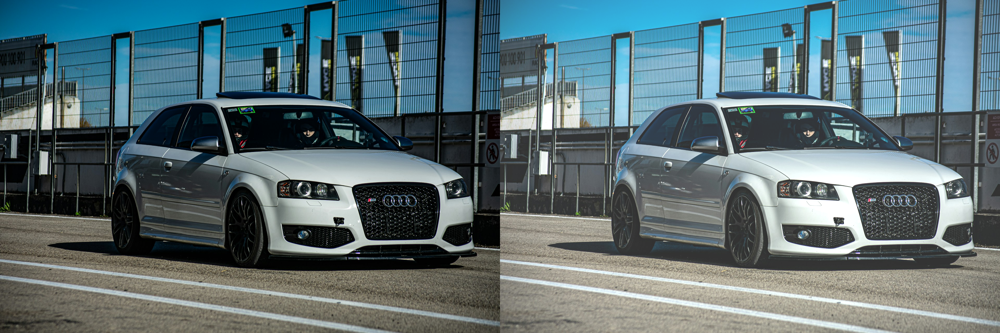

In [3]:
import cv2 as cv
import numpy as np
import matplotlib.pyplot as plt
from google.colab.patches import cv2_imshow

print('Mengubah tingkat kecerahan citra')
print('--------------------------------')
try:
  brightness = int(input('Masukkan nilai kecerahan: '))
except ValueError:
  print('Error, not a number')

original = cv.imread('/content/drive/MyDrive/audicar.jpg') # Change url with your image from gdrive
brightness_image = np.zeros(original.shape, original.dtype)

# Every pixel access
for y in range(original.shape[0]):
  for x in range(original.shape[1]):
    for c in range(original.shape[2]):
      brightness_image[y,x,c] = np.clip(original[y,x,c] + brightness, 0, 255)

# Simple way without for loop
# brightness_image = cv.convertScaleAbs(original, beta=brightness)

final_frame = cv.hconcat((original, brightness_image))
cv2_imshow(final_frame)

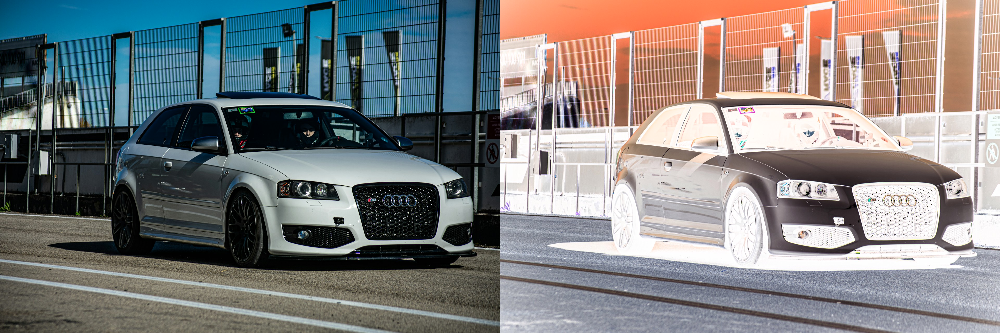

In [12]:
original = cv.imread('/content/drive/MyDrive/audicar.jpg') # Change url with your image from gdrive
inverted_image = cv.bitwise_not(original)

final_frame = cv.hconcat((original, inverted_image))
cv2_imshow(final_frame)

Mengubah kontras dan tingkat kecerahan citra
--------------------------------
Masukkan tingkat kecerahan [-255 - 255]: 50
Masukkan kontras [1.0 - 3.0]: 2


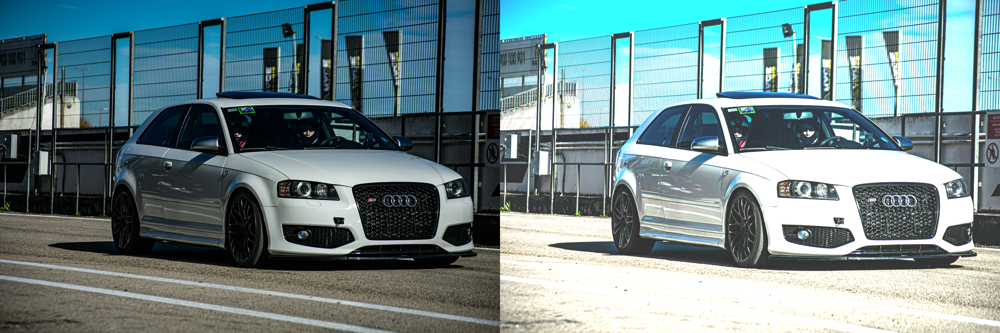

In [4]:
print('Mengubah kontras dan tingkat kecerahan citra')
print('--------------------------------')
try:
    brightness = int(input('Masukkan tingkat kecerahan [-255 - 255]: '))
    contrast = float(input('Masukkan kontras [1.0 - 3.0]: '))
except ValueError:
    print('Error, input tidak valid')
    brightness = 0  # Nilai default jika input tidak valid
    contrast = 1.0  # Nilai default jika input tidak valid

original = cv.imread('/content/drive/MyDrive/audicar.jpg')  # Pastikan path gambar benar
if original is None:
    print('Error: Image not found')
    exit()

# Adjust brightness and contrast
brightness_image = cv.convertScaleAbs(original, alpha=contrast, beta=brightness)

# Concatenate original and brightness-adjusted images
final_frame = cv.hconcat([original, brightness_image])

# Display the images
cv2_imshow(final_frame)

Mengubah tingkat kecerahan citra dengan Transformasi Log
--------------------------------
Masukkan nilai kecerahan: 50


<ipython-input-5-63418b1b21e4>:16: RuntimeWarning: divide by zero encountered in log
  log_transformed = c * (np.log(1 + original + brightness))
<ipython-input-5-63418b1b21e4>:19: RuntimeWarning: invalid value encountered in cast
  log_transformed = np.array(log_transformed, dtype=np.uint8)


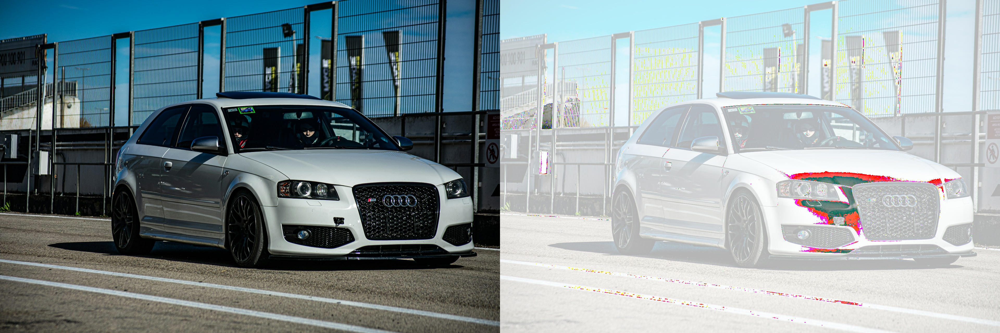

In [5]:
print('Mengubah tingkat kecerahan citra dengan Transformasi Log')
print('--------------------------------')
try:
    brightness = int(input('Masukkan nilai kecerahan: '))
except ValueError:
    print('Error, input tidak valid')
    brightness = 0  # Nilai default jika input tidak valid

original = cv.imread('/content/drive/MyDrive/audicar.jpg')  # Pastikan path gambar benar
if original is None:
    print('Error: Image not found')
    exit()

# Terapkan Transformasi Log
c = 255 / np.log(1 + np.max(original))
log_transformed = c * (np.log(1 + original + brightness))

# Ubah tipe data menjadi uint8
log_transformed = np.array(log_transformed, dtype=np.uint8)

# Gabungkan gambar asli dan gambar dengan transformasi log
final_frame = cv.hconcat([original, log_transformed])

# Tampilkan gambar
cv2_imshow(final_frame)